<a href="https://colab.research.google.com/github/pranay8297/deep-learning-projects/blob/master/rossman_from_scratch.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install ipdb

     |████████████████████████████████| 793 kB 8.5 MB/s 
     |████████████████████████████████| 381 kB 78.3 MB/s 
  Created wheel for ipdb: filename=ipdb-0.13.9-py3-none-any.whl size=11648 sha256=cd86a3cdc9b64e8420fe6a911d6701134c7d39c186212126e4fd22015cc4dded
  Stored in directory: /root/.cache/pip/wheels/65/cd/cc/aaf92acae337a28fdd2aa4d632196a59745c8c39f76eaeed01
Successfully built ipdb
  Attempting uninstall: prompt-toolkit
    Found existing installation: prompt-toolkit 1.0.18
    Uninstalling prompt-toolkit-1.0.18:
      Successfully uninstalled prompt-toolkit-1.0.18
  Attempting uninstall: ipython
    Found existing installation: ipython 5.5.0
    Uninstalling ipython-5.5.0:
      Successfully uninstalled ipython-5.5.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
jupyter-console 5.2.0 requires prompt-toolkit<2.0.0,>=1.0.0, but you have prompt-toolkit 

In [2]:
from ipdb import set_trace as st
from fastai.tabular import *
from fastai.vision import *

In [3]:
from fastai.datasets import URLs

In [4]:
import seaborn as sns

In [5]:
from google.colab import files
files.upload()

Saving rossman.zip to rossman.zip


{'rossman.zip': b'PK\x03\x04-\x00\x00\x00\x08\x00 \x1f\x8bOr\x1d\x97\xdc\xff\xff\xff\xff\xff\xff\xff\xff\x15\x00\x14\x00sample_submission.csv\x01\x00\x10\x00\xab\xd8\x04\x00\x00\x00\x00\x00\xf1X\x01\x00\x00\x00\x00\x00<\xdd;\x92l;W\xa8Q\x9ff\xfc6FJ\xf3\xa5l\xc2\xb5i\xc1\x8d\x00\x0f\x8f\xfeGpRC\x85\xb1\xb1\xb62\x80\xfaNU\xed9\x96\xe6\xfa\xd7\xff\xfb\xcf\x7f\xfd\xfb\xbf\xfe\xe3\xff\xff\xf7\x7f\xfd\xcf\xbf\xfem\xfd\xfb\xe7\xdf\xf6?\x7f\xe2\x9f?\xf9\xcf\x9f\xfa\xe7O\xff\xf3g\xfe\xf9s\xfe\xf9\xf3\xfd\xe7\xcf\xfa\xfc\xfe\xc7\xefo\xae\xdf_]\xbf\xbf\xbb~\x7fy\xfd\xfe\xf6\xfa\xfd\xf5\xf5\xfb\xfb\xebw`\xfdN\xec\xdf\x89}?\xfbwb\xffN\xec\xdf\x89\xfd;\xb1\x7f\'\xf6\xef\xc4\xfe\x9d\xd8\xbf\x13\xf1;\x11\xbf\x13q\xff\xd7\xf9\x9d\x88\xdf\x89\xf8\x9d\x88\xdf\x89\xf8\x9d\x88\xdf\x89\xf8\x9d\xc8\xdf\x89\xfc\x9d\xc8\xdf\x89\xbc\xff\x17\xfcN\xe4\xefD\xfeN\xe4\xefD\xfeN\xe4\xefD\xfdN\xd4\xefD\xfdN\xd4\xefD\xdd\xff\xa3\x7f\'\xeaw\xa2~\'\xeaw\xa2~\'\xfaw\xa2\x7f\'\xfaw\xa2\x7f\'\xfaw\xa2\xef\xff\x9f~\'\xfaw\xa

In [6]:
!ls

rossman.zip  sample_data


In [7]:
!unzip rossman.zip

Archive:  rossman.zip
  inflating: sample_submission.csv   
  inflating: store.csv               
  inflating: test.csv                
  inflating: train.csv               


In [11]:
!pwd

/content


In [31]:
path = Path('/content')
# path.ls()
train = pd.read_csv(path/'train.csv')
stores = pd.read_csv(path/'store.csv')
test = pd.read_csv(path/'test.csv')

/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: DtypeWarning:

Columns (7) have mixed types.Specify dtype option on import or set low_memory=False.



In [32]:
train.head()

,Store,DayOfWeek,Date,Sales,Customers,Open,Promo,StateHoliday,SchoolHoliday
0,1,5,2015-07-31,5263,555,1,1,0,1
1,2,5,2015-07-31,6064,625,1,1,0,1
2,3,5,2015-07-31,8314,821,1,1,0,1
3,4,5,2015-07-31,13995,1498,1,1,0,1
4,5,5,2015-07-31,4822,559,1,1,0,1


In [24]:
stores.head()

,Store,StoreType,Assortment,CompetitionDistance,CompetitionOpenSinceMonth,CompetitionOpenSinceYear,Promo2,Promo2SinceWeek,Promo2SinceYear,PromoInterval
0,1,c,a,1270.0,9.0,2008.0,0,NaN,NaN,NaN
1,2,a,a,570.0,11.0,2007.0,1,13.0,2010.0,"Jan,Apr,Jul,Oct"
2,3,a,a,14130.0,12.0,2006.0,1,14.0,2011.0,"Jan,Apr,Jul,Oct"
3,4,c,c,620.0,9.0,2009.0,0,NaN,NaN,NaN
4,5,a,a,29910.0,4.0,2015.0,0,NaN,NaN,NaN


In [25]:
test.head()

,Id,Store,DayOfWeek,Date,Open,Promo,StateHoliday,SchoolHoliday
0,1,1,4,2015-09-17,1.0,1,0,0
1,2,3,4,2015-09-17,1.0,1,0,0
2,3,7,4,2015-09-17,1.0,1,0,0
3,4,8,4,2015-09-17,1.0,1,0,0
4,5,9,4,2015-09-17,1.0,1,0,0


In [26]:
train.isna().sum()

Store            0
DayOfWeek        0
Date             0
Sales            0
Customers        0
Open             0
Promo            0
StateHoliday     0
SchoolHoliday    0
dtype: int64

In [27]:
stores.isna().sum()

Store                          0
StoreType                      0
Assortment                     0
CompetitionDistance            3
CompetitionOpenSinceMonth    354
CompetitionOpenSinceYear     354
Promo2                         0
Promo2SinceWeek              544
Promo2SinceYear              544
PromoInterval                544
dtype: int64

In [15]:
#test


In [33]:
x = stores.copy()
x["Promo2SinceWeek_missing"] = x["Promo2SinceWeek"].isna()
missing_vars = ["CompetitionDistance", "CompetitionOpenSinceMonth", "CompetitionOpenSinceYear", "Promo2SinceWeek", "Promo2SinceYear", "PromoInterval"]

In [34]:
print(stores['CompetitionOpenSinceMonth'].unique())
print(stores['CompetitionOpenSinceYear'].unique())
print(stores['Promo2SinceWeek'].unique())
print(stores['Promo2SinceYear'].unique())
print(stores['PromoInterval'].unique())

[ 9. 11. 12.  4. 10.  8. nan  3.  6.  5.  1.  2.  7.]
[2008. 2007. 2006. 2009. 2015. 2013. 2014. 2000. 2011.   nan 2010. 2005. 1999. 2003. 2012. 2004. 2002. 1961. 1995.
 2001. 1990. 1994. 1900. 1998.]
[nan 13. 14.  1. 45. 40. 26. 22.  5.  6. 10. 31. 37.  9. 39. 27. 18. 35. 23. 48. 36. 50. 44. 49. 28.]
[  nan 2010. 2011. 2012. 2009. 2014. 2015. 2013.]
[nan 'Jan,Apr,Jul,Oct' 'Feb,May,Aug,Nov' 'Mar,Jun,Sept,Dec']


In [35]:
for i in missing_vars:
  stores[f'{i}_missing'] = stores[i].isna()

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


(<matplotlib.axes._subplots.AxesSubplot at 0x7ff526f93610>, 2325.0)

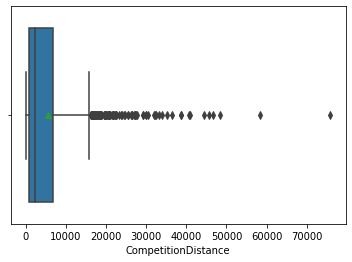

In [32]:
sns.boxplot(stores['CompetitionDistance'], showmeans = True), stores['CompetitionDistance'].median()

In [36]:
stores['CompetitionDistance'].fillna(value = stores['CompetitionDistance'].median(), inplace = True)
stores['CompetitionOpenSinceYear'].fillna(value = 1800.0, inplace = True)
stores['CompetitionOpenSinceMonth'].fillna(value = 16.0, inplace = True)
stores['Promo2SinceWeek'].fillna(value = 60.0, inplace = True)
stores['Promo2SinceYear'].fillna(value = 70.0, inplace = True)
stores['PromoInterval'].fillna(value = 'misssing', inplace = True)

In [36]:
stores

,Store,StoreType,Assortment,CompetitionDistance,CompetitionOpenSinceMonth,CompetitionOpenSinceYear,Promo2,Promo2SinceWeek,Promo2SinceYear,PromoInterval,CompetitionDistance_missing,CompetitionOpenSinceMonth_missing,CompetitionOpenSinceYear_missing,Promo2SinceWeek_missing,Promo2SinceYear_missing,PromoInterval_missing
0,1,c,a,1270.0,9.0,2008.0,0,60.0,70.0,misssing,False,False,False,True,True,True
1,2,a,a,570.0,11.0,2007.0,1,13.0,2010.0,"Jan,Apr,Jul,Oct",False,False,False,False,False,False
2,3,a,a,14130.0,12.0,2006.0,1,14.0,2011.0,"Jan,Apr,Jul,Oct",False,False,False,False,False,False
3,4,c,c,620.0,9.0,2009.0,0,60.0,70.0,misssing,False,False,False,True,True,True
4,5,a,a,29910.0,4.0,2015.0,0,60.0,70.0,misssing,False,False,False,True,True,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1110,1111,a,a,1900.0,6.0,2014.0,1,31.0,2013.0,"Jan,Apr,Jul,Oct",False,False,False,False,False,False
1111,1112,c,c,1880.0,4.0,2006.0,0,60.0,70.0,misssing,False,False,False,True,True,True
1112,1113,a,c,9260.0,16.0,1800.0,0,60.0,70.0,misssing,False,True,True,True,True,True
1113,1114,a,c,870.0,16.0,1800.0,0,60.0,70.0,misssing,False,True,True,True,True,True


In [37]:
stores.isna().sum()

Store                                0
StoreType                            0
Assortment                           0
CompetitionDistance                  0
CompetitionOpenSinceMonth            0
CompetitionOpenSinceYear             0
Promo2                               0
Promo2SinceWeek                      0
Promo2SinceYear                      0
PromoInterval                        0
CompetitionDistance_missing          0
CompetitionOpenSinceMonth_missing    0
CompetitionOpenSinceYear_missing     0
Promo2SinceWeek_missing              0
Promo2SinceYear_missing              0
PromoInterval_missing                0
dtype: int64

In [38]:
train.head()

,Store,DayOfWeek,Date,Sales,Customers,Open,Promo,StateHoliday,SchoolHoliday
0,1,5,2015-07-31,5263,555,1,1,0,1
1,2,5,2015-07-31,6064,625,1,1,0,1
2,3,5,2015-07-31,8314,821,1,1,0,1
3,4,5,2015-07-31,13995,1498,1,1,0,1
4,5,5,2015-07-31,4822,559,1,1,0,1


In [39]:
train.isna().sum()

Store            0
DayOfWeek        0
Date             0
Sales            0
Customers        0
Open             0
Promo            0
StateHoliday     0
SchoolHoliday    0
dtype: int64

In [37]:
def add_datepart(df, fldname, drop=True, time=False):
    "Helper function that adds columns relevant to a date."
    fld = df[fldname]
    fld_dtype = fld.dtype
    if isinstance(fld_dtype, pd.core.dtypes.dtypes.DatetimeTZDtype):
        fld_dtype = np.datetime64

    if not np.issubdtype(fld_dtype, np.datetime64):
        df[fldname] = fld = pd.to_datetime(fld, infer_datetime_format=True)
    targ_pre = re.sub('[Dd]ate$', '', fldname)
    attr = ['Year', 'Month', 'Week', 'Day', 'Dayofweek', 'Dayofyear',
            'Is_month_end', 'Is_month_start', 'Is_quarter_end', 'Is_quarter_start', 'Is_year_end', 'Is_year_start']
    if time: attr = attr + ['Hour', 'Minute', 'Second']
    for n in attr: df[targ_pre + n] = getattr(fld.dt, n.lower())
    df[targ_pre + 'Elapsed'] = fld.astype(np.int64) // 10 ** 9
    if drop: df.drop(fldname, axis=1, inplace=True)

In [38]:
add_datepart(train, 'Date', drop = False)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:14: FutureWarning:

Series.dt.weekofyear and Series.dt.week have been deprecated.  Please use Series.dt.isocalendar().week instead.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:15: FutureWarning:

casting datetime64[ns] values to int64 with .astype(...) is deprecated and will raise in a future version. Use .view(...) instead.



In [39]:
train.head()

,Store,DayOfWeek,Date,Sales,Customers,Open,Promo,StateHoliday,SchoolHoliday,Year,...,Day,Dayofweek,Dayofyear,Is_month_end,Is_month_start,Is_quarter_end,Is_quarter_start,Is_year_end,Is_year_start,Elapsed
0,1,5,2015-07-31,5263,555,1,1,0,1,2015,...,31,4,212,True,False,False,False,False,False,1438300800
1,2,5,2015-07-31,6064,625,1,1,0,1,2015,...,31,4,212,True,False,False,False,False,False,1438300800
2,3,5,2015-07-31,8314,821,1,1,0,1,2015,...,31,4,212,True,False,False,False,False,False,1438300800
3,4,5,2015-07-31,13995,1498,1,1,0,1,2015,...,31,4,212,True,False,False,False,False,False,1438300800
4,5,5,2015-07-31,4822,559,1,1,0,1,2015,...,31,4,212,True,False,False,False,False,False,1438300800


In [43]:
stores.head()

,Store,StoreType,Assortment,CompetitionDistance,CompetitionOpenSinceMonth,CompetitionOpenSinceYear,Promo2,Promo2SinceWeek,Promo2SinceYear,PromoInterval,CompetitionDistance_missing,CompetitionOpenSinceMonth_missing,CompetitionOpenSinceYear_missing,Promo2SinceWeek_missing,Promo2SinceYear_missing,PromoInterval_missing
0,1,c,a,1270.0,9.0,2008.0,0,60.0,70.0,misssing,False,False,False,True,True,True
1,2,a,a,570.0,11.0,2007.0,1,13.0,2010.0,"Jan,Apr,Jul,Oct",False,False,False,False,False,False
2,3,a,a,14130.0,12.0,2006.0,1,14.0,2011.0,"Jan,Apr,Jul,Oct",False,False,False,False,False,False
3,4,c,c,620.0,9.0,2009.0,0,60.0,70.0,misssing,False,False,False,True,True,True
4,5,a,a,29910.0,4.0,2015.0,0,60.0,70.0,misssing,False,False,False,True,True,True


In [40]:
data = train.merge(stores, on = 'Store')

In [45]:
data.head()

,Store,DayOfWeek,Date,Sales,Customers,Open,Promo,StateHoliday,SchoolHoliday,Year,...,Promo2,Promo2SinceWeek,Promo2SinceYear,PromoInterval,CompetitionDistance_missing,CompetitionOpenSinceMonth_missing,CompetitionOpenSinceYear_missing,Promo2SinceWeek_missing,Promo2SinceYear_missing,PromoInterval_missing
0,1,5,2015-07-31,5263,555,1,1,0,1,2015,...,0,60.0,70.0,misssing,False,False,False,True,True,True
1,1,4,2015-07-30,5020,546,1,1,0,1,2015,...,0,60.0,70.0,misssing,False,False,False,True,True,True
2,1,3,2015-07-29,4782,523,1,1,0,1,2015,...,0,60.0,70.0,misssing,False,False,False,True,True,True
3,1,2,2015-07-28,5011,560,1,1,0,1,2015,...,0,60.0,70.0,misssing,False,False,False,True,True,True
4,1,1,2015-07-27,6102,612,1,1,0,1,2015,...,0,60.0,70.0,misssing,False,False,False,True,True,True


In [26]:
data['Date']

0         2015-07-31
1         2015-07-30
2         2015-07-29
3         2015-07-28
4         2015-07-27
             ...    
1017204   2013-01-05
1017205   2013-01-04
1017206   2013-01-03
1017207   2013-01-02
1017208   2013-01-01
Name: Date, Length: 1017209, dtype: datetime64[ns]

In [41]:
data.sort_values('Date', inplace = True)

In [48]:
data.head()

,Store,DayOfWeek,Date,Sales,Customers,Open,Promo,StateHoliday,SchoolHoliday,Year,...,Promo2,Promo2SinceWeek,Promo2SinceYear,PromoInterval,CompetitionDistance_missing,CompetitionOpenSinceMonth_missing,CompetitionOpenSinceYear_missing,Promo2SinceWeek_missing,Promo2SinceYear_missing,PromoInterval_missing
1017208,1115,2,2013-01-01,0,0,0,0,a,1,2013,...,1,22.0,2012.0,"Mar,Jun,Sept,Dec",False,True,True,False,False,False
679363,746,2,2013-01-01,0,0,0,0,a,1,2013,...,1,35.0,2011.0,"Mar,Jun,Sept,Dec",False,False,False,False,False,False
155193,171,2,2013-01-01,0,0,0,0,a,1,2013,...,0,60.0,70.0,misssing,False,True,True,True,True,True
632403,694,2,2013-01-01,0,0,0,0,a,1,2013,...,1,40.0,2014.0,"Jan,Apr,Jul,Oct",False,False,False,False,False,False
361623,396,2,2013-01-01,0,0,0,0,a,1,2013,...,0,60.0,70.0,misssing,False,True,True,True,True,True


In [42]:
data.columns

Index(['Store', 'DayOfWeek', 'Date', 'Sales', 'Customers', 'Open', 'Promo',
       'StateHoliday', 'SchoolHoliday', 'Year', 'Month', 'Week', 'Day',
       'Dayofweek', 'Dayofyear', 'Is_month_end', 'Is_month_start',
       'Is_quarter_end', 'Is_quarter_start', 'Is_year_end', 'Is_year_start',
       'Elapsed', 'StoreType', 'Assortment', 'CompetitionDistance',
       'CompetitionOpenSinceMonth', 'CompetitionOpenSinceYear', 'Promo2',
       'Promo2SinceWeek', 'Promo2SinceYear', 'PromoInterval',
       'CompetitionDistance_missing', 'CompetitionOpenSinceMonth_missing',
       'CompetitionOpenSinceYear_missing', 'Promo2SinceWeek_missing',
       'Promo2SinceYear_missing', 'PromoInterval_missing'],
      dtype='object')

In [ ]:
# group by average - sales for each stores - Plot
# group by average - sales for each year - Plot
# dot plot between x - CompetitionDistance and y - sales

In [18]:
x = data.groupby('Store').mean()

In [19]:
import plotly.express as px
fig = px.line(x, y="Sales", title='Rossman Sales per store')
fig.show()

In [31]:
correlation = data.corr()

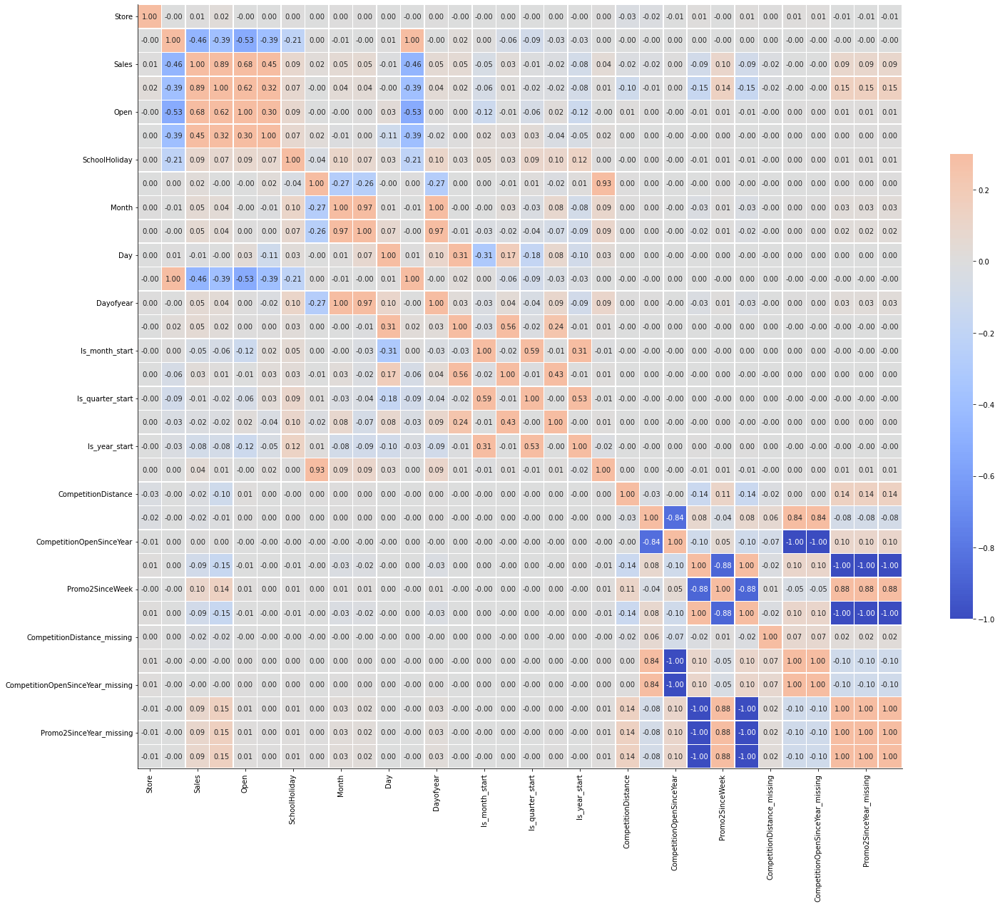

In [ ]:
g = sns.heatmap(correlation,  vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5}, annot=True, fmt='.2f', cmap='coolwarm')
sns.despine()
g.figure.set_size_inches(24,24)
    
plt.show()

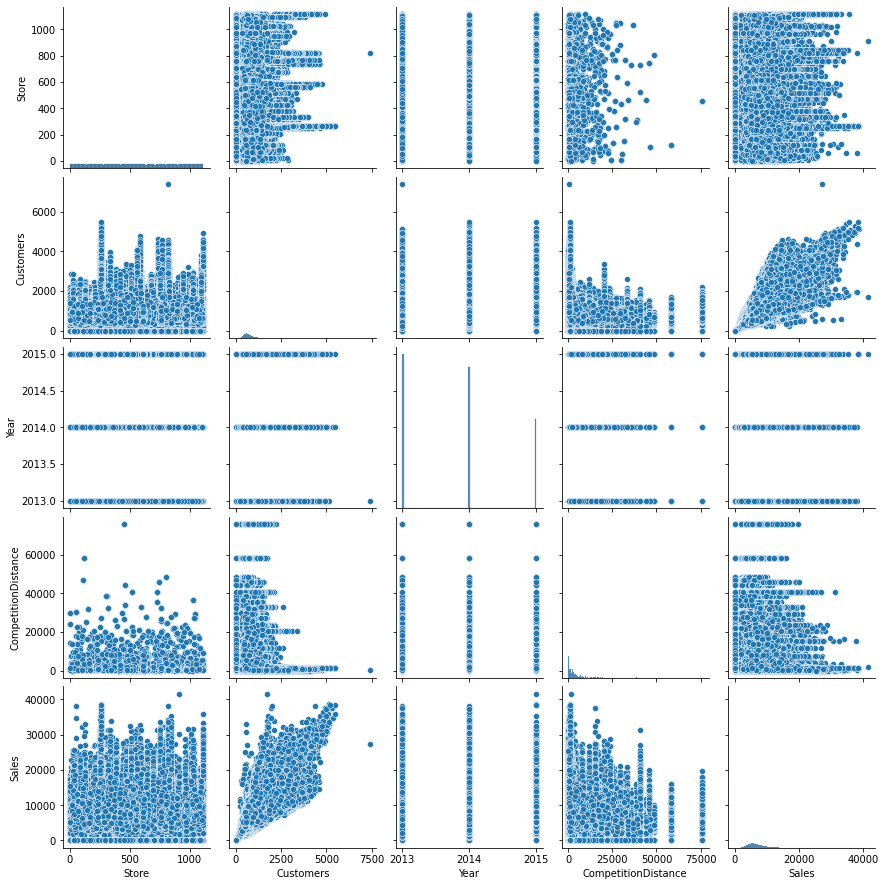

In [ ]:
g = sns.pairplot(data[['Store','Customers','Year','CompetitionDistance', 'Sales']])

In [43]:
data.columns

Index(['Store', 'DayOfWeek', 'Date', 'Sales', 'Customers', 'Open', 'Promo',
       'StateHoliday', 'SchoolHoliday', 'Year', 'Month', 'Week', 'Day',
       'Dayofweek', 'Dayofyear', 'Is_month_end', 'Is_month_start',
       'Is_quarter_end', 'Is_quarter_start', 'Is_year_end', 'Is_year_start',
       'Elapsed', 'StoreType', 'Assortment', 'CompetitionDistance',
       'CompetitionOpenSinceMonth', 'CompetitionOpenSinceYear', 'Promo2',
       'Promo2SinceWeek', 'Promo2SinceYear', 'PromoInterval',
       'CompetitionDistance_missing', 'CompetitionOpenSinceMonth_missing',
       'CompetitionOpenSinceYear_missing', 'Promo2SinceWeek_missing',
       'Promo2SinceYear_missing', 'PromoInterval_missing'],
      dtype='object')

In [44]:
data = data.drop(columns = ["Date"])

In [45]:
categorical_vars = ['Store', 'DayOfWeek', 'Open', 'Promo','StateHoliday', 'SchoolHoliday', 'Year', 'Month', 'Week', 'Day','Dayofweek', 'Is_month_end', 'Is_month_start',
       'Is_quarter_end', 'Is_quarter_start', 'Is_year_end', 'Is_year_start','Elapsed', 'StoreType', 'Assortment','CompetitionOpenSinceMonth', 'CompetitionOpenSinceYear', 'Promo2',
       'Promo2SinceWeek', 'Promo2SinceYear', 'PromoInterval','CompetitionDistance_missing', 'CompetitionOpenSinceMonth_missing','CompetitionOpenSinceYear_missing', 'Promo2SinceWeek_missing',
       'Promo2SinceYear_missing', 'PromoInterval_missing']

cont_vars = ["Customers", 'Dayofyear', "CompetitionDistance"]
dep_var = 'Sales'

In [46]:
len(train), (len(test) + 60633)/len(train), len(train)*0.1 - len(test)
valid_idx = len(train) - int(len(train)*0.1)

In [47]:
valid_idxs = range(valid_idx, len(train) - 1)

In [48]:
df = data.copy()
df['Sales'] = df['Sales'] + 1e-02

In [49]:
from fastai.data_block import FloatList
from fastai.tabular.transform import Categorify
from fastai.tabular.data import TabularList
datab = TabularList.from_df(df, path = path, cat_names = categorical_vars, cont_names= cont_vars, procs = [Categorify, Normalize]).split_by_idx(valid_idx = valid_idxs).label_from_df(cols = dep_var, label_cls = FloatList, log = True).databunch()

In [50]:
datab.show_batch()

Store,DayOfWeek,Open,Promo,StateHoliday,SchoolHoliday,Year,Month,Week,Day,Dayofweek,Is_month_end,Is_month_start,Is_quarter_end,Is_quarter_start,Is_year_end,Is_year_start,Elapsed,StoreType,Assortment,CompetitionOpenSinceMonth,CompetitionOpenSinceYear,Promo2,Promo2SinceWeek,Promo2SinceYear,PromoInterval,CompetitionDistance_missing,CompetitionOpenSinceMonth_missing,CompetitionOpenSinceYear_missing,Promo2SinceWeek_missing,Promo2SinceYear_missing,PromoInterval_missing,Customers,Dayofyear,CompetitionDistance,target
147,2,1,0,0,0,2013,9,38,17,1,False,False,False,False,False,False,1379376000,d,c,16.0,1800.0,0,60.0,70.0,misssing,False,True,True,True,True,True,0.1537,0.9203,0.4039,8.650851
523,2,1,0,0,1,2013,12,1,31,1,True,False,True,False,True,False,1388448000,c,c,11.0,2013.0,0,60.0,70.0,misssing,False,False,False,True,True,True,1.4419,1.9040,-0.6968,9.297436
620,2,1,1,0,0,2013,9,39,24,1,False,False,False,False,False,False,1379980800,d,c,16.0,1800.0,1,40.0,2014.0,"Jan,Apr,Jul,Oct",False,True,True,False,False,False,0.1774,0.9859,0.0020,8.847793
586,2,1,0,0,1,2013,7,30,23,1,False,False,False,False,False,False,1374537600,a,c,10.0,2008.0,0,60.0,70.0,misssing,False,False,False,True,True,True,2.7451,0.3957,-0.6709,9.22039
349,3,1,1,0,1,2013,7,27,3,2,False,False,False,False,False,False,1372809600,c,c,4.0,2009.0,0,60.0,70.0,misssing,False,False,False,True,True,True,0.2720,0.2083,-0.5101,8.8917885


In [51]:
data = datab

In [52]:
y_range = torch.Tensor([np.log(np.min(df['Sales'] * 1.2)), np.log(np.max(df['Sales'] * 1.2))])

In [53]:
y_range

tensor([-4.4228, 10.8170])

In [54]:
from fastai.metrics import accuracy
from fastai.tabular.learner import tabular_learner
#tabular_learner(data:DataBunch, layers:Collection[int], emb_szs:Dict[str,int]=None, metrics=None,
        #ps:Collection[float]=None, emb_drop:float=0., y_range:OptRange=None, use_bn:bool=True, **learn_kwargs):
learn = tabular_learner(data, layers = [1000, 500], y_range = y_range)

epoch,train_loss,valid_loss,time


LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


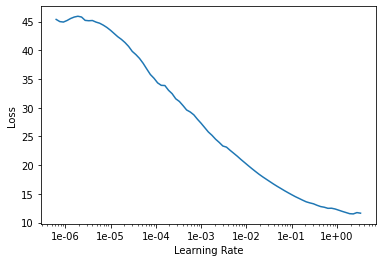

In [55]:
learn.lr_find()
learn.recorder.plot()

In [56]:
learn.save('st_1')

In [57]:
learn.load('st_1')
learn.fit_one_cycle(1, 1e-03)

epoch,train_loss,valid_loss,time
0,0.012013,0.061724,02:19


In [97]:
#mmap -> mean of delta/act
def mape(yhat, y):
  yhat.squeeze_()
  diff = torch.abs((yhat-y)/y)
  # print(diff, y)
  return round((1 - torch.mean(diff).item()), 3)*100

In [60]:
#test
x, y = next(iter(data.valid_dl))
yhat = learn.model(*x)
yhat.squeeze_()
# mape(yhat, y)

tensor([-4.4223, -4.4223, -4.4222, -4.4224, -4.4226, -4.4223, -4.4223, -4.4224,
        -4.4222, -4.4221, -4.4224, -4.4221, -4.4226, -4.4227,  9.7251, -4.4222,
        -4.4222, -4.4225, -4.4221, -4.4223, -4.4223, -4.4223, -4.4221, -4.4225,
        -4.4223, -4.4221, -4.4219, -4.4225, -4.4224, -4.4219, -4.4222, -4.4222,
        -4.4223, -4.4224, -4.4224, -4.4224, -4.4225, -4.4222, -4.4224, -4.4221,
        -4.4220, -4.4221, -4.4223, -4.4224, -4.4222, -4.4224, -4.4222, -4.4225,
        -4.4223, -4.4226, -4.4222, -4.4225, -4.4224, -4.4223, -4.4224, -4.4222,
        -4.4222, -4.4223, -4.4219, -4.4222, -4.4222, -4.4224, -4.4224, -4.4222],
       device='cuda:0', grad_fn=<SqueezeBackward2>)

In [61]:
yhat, y

(tensor([-4.4223, -4.4223, -4.4222, -4.4224, -4.4226, -4.4223, -4.4223, -4.4224,
         -4.4222, -4.4221, -4.4224, -4.4221, -4.4226, -4.4227,  9.7251, -4.4222,
         -4.4222, -4.4225, -4.4221, -4.4223, -4.4223, -4.4223, -4.4221, -4.4225,
         -4.4223, -4.4221, -4.4219, -4.4225, -4.4224, -4.4219, -4.4222, -4.4222,
         -4.4223, -4.4224, -4.4224, -4.4224, -4.4225, -4.4222, -4.4224, -4.4221,
         -4.4220, -4.4221, -4.4223, -4.4224, -4.4222, -4.4224, -4.4222, -4.4225,
         -4.4223, -4.4226, -4.4222, -4.4225, -4.4224, -4.4223, -4.4224, -4.4222,
         -4.4222, -4.4223, -4.4219, -4.4222, -4.4222, -4.4224, -4.4224, -4.4222],
        device='cuda:0', grad_fn=<SqueezeBackward2>),
 tensor([-4.6052, -4.6052, -4.6052, -4.6052, -4.6052, -4.6052, -4.6052, -4.6052,
         -4.6052, -4.6052, -4.6052, -4.6052, -4.6052, -4.6052,  9.8984, -4.6052,
         -4.6052, -4.6052, -4.6052, -4.6052, -4.6052, -4.6052, -4.6052, -4.6052,
         -4.6052, -4.6052, -4.6052, -4.6052, -4.6052, 

In [85]:
# My own model - Replacing fastai stuff with my own updates- optim.Adam and nn.sequential stuff

'''
Data - Ready
Model - architecture - Regular Embeddings for with dropout and batchnorm 
loss function - RMSE loss function
optimizer - Adam Optmizer
'''

In [ ]:
drop = nn.Dropout(0.2)
drop(yhat)

In [121]:
bn = nn.BatchNorm1d(1).cuda()

In [116]:
yhat.shape

torch.Size([64])

In [122]:
nyhat = bn(yhat)

In [124]:
nyhat.squeeze()

tensor([-0.1282, -0.1228, -0.1130, -0.1337, -0.1300, -0.1236, -0.1296, -0.1253,
        -0.1198, -0.1299, -0.1187, -0.1211, -0.1233, -0.1283,  7.9348, -0.1241,
        -0.1267, -0.1269, -0.1265, -0.1365, -0.1267, -0.1210, -0.1277, -0.1259,
        -0.1298, -0.1268, -0.1361, -0.1271, -0.1307, -0.1163, -0.1291, -0.1267,
        -0.1306, -0.1226, -0.1256, -0.1284, -0.1227, -0.1115, -0.1202, -0.1228,
        -0.1271, -0.1227, -0.1169, -0.1282, -0.1241, -0.1188, -0.1282, -0.1290,
        -0.1257, -0.1295, -0.1303, -0.1339, -0.1282, -0.1283, -0.1269, -0.1173,
        -0.1298, -0.1299, -0.1340, -0.1224, -0.1291, -0.1304, -0.1272, -0.1201],
       device='cuda:0', grad_fn=<SqueezeBackward0>)

In [128]:
emb = nn.Embedding(30, 20)
emb.embedding_dim

20

In [63]:
x_cat, x_cont = x

In [138]:
temp = [e(x_cat[:,i]) for i,e in enumerate(learn.model.embeds)]
c = 0
for i in temp:
 c += i.shape[1]


292

In [139]:
ntemp = torch.cat(temp, 1)
nntemp = torch.cat([ntemp, x_cont], 1)

In [156]:
data.cont_names

['Customers', 'Dayofyear', 'CompetitionDistance']

In [160]:
a = ['a', 'b']
for i, j in enumerate(a):
  print(i, j)

0 a
1 b


In [193]:
x_cat[:, 22].shape

torch.Size([64])

In [64]:
x_cat

tensor([[ 329,    5,    1,  ...,    1,    1,    1],
        [  10,    5,    1,  ...,    2,    2,    2],
        [1003,    5,    1,  ...,    1,    1,    1],
        ...,
        [ 191,    5,    1,  ...,    1,    1,    1],
        [ 306,    5,    1,  ...,    1,    1,    1],
        [ 437,    5,    1,  ...,    1,    1,    1]], device='cuda:0')

In [80]:
class MyTabularLearner(nn.Module):
  def __init__(self, data, layers, ps, emb_drop):
    super().__init__()
    # Create Embeddings for all categorical data - Get sizes and create embeeding for each
    # Create dropout layers
    # Create batch norms for each layers
    # Creata Linears - with all infeatures
    # if categorical data - Create new
    self.emb_drop = nn.Dropout(emb_drop)
    self.sizes = data.get_emb_szs()
    self.embs = nn.ModuleList([nn.Embedding(ni, nf) for ni, nf in self.sizes])
    total_inputs = len(data.cont_names)
    for i in self.embs:
      total_inputs += i.embedding_dim
    # This is for outputing one value for the final layer
    # layers.append(1)

    self.layers = []
    for i, j in zip(layers, ps):
      self.layers += self.lin_bn_drop(total_inputs, i, j)
      total_inputs = i
    fin_layer = [
       nn.Linear(layers[-1], 1),
       nn.ReLU(),
       nn.BatchNorm1d(1),   
    ]

    self.layers += fin_layer
    self.arch = nn.Sequential(*self.layers)

  def lin_bn_drop(self, ni, no, dp):

    layers = [
       nn.Linear(ni, no),
       nn.ReLU(),
       nn.BatchNorm1d(no),
       nn.Dropout(dp),      
    ]
    return layers
  
  def forward(self, x_cat, x_cont):

    '''
    [ 329,    5,    1,  ...,    1,    1,    1],
    [  10,    5,    1,  ...,    2,    2,    2],
    [1003,    5,    1,  ...,    1,    1,    1],
    '''
    cat_inputs = []
    for index in range(len(x_cat[0])):
      emb = self.embs[index]
      values = emb(x_cat[:, index])
      cat_inputs.append(values)

    final_inputs = torch.cat(cat_inputs, dim = 1)
    final_inputs = torch.cat([final_inputs, x_cont], dim = 1)
    # print(final_inputs.shape)
    return self.arch(final_inputs)

  

In [103]:
model = MyTabularLearner(data, [1000, 500, 200], [0.05, 0.1, 0.1], 0.1).cuda()

In [83]:
yhat = model(x_cat, x_cont)  

In [86]:
yhat.shape, y.shape

(torch.Size([64, 1]), torch.Size([64]))

In [90]:
class RMSELoss(nn.Module):
    def __init__(self):
        super().__init__()
        self.mse = nn.MSELoss()
        
    def forward(self,yhat,y):
        if (yhat.shape != y.shape):
          yhat.squeeze_(1)
        return torch.sqrt(self.mse(yhat,y))
loss_func = RMSELoss()

In [91]:
loss_func(yhat, y)

tensor(4.6491, device='cuda:0', grad_fn=<SqrtBackward0>)

In [100]:
def moving_avg(arr, ws):
  window = arr[len(arr) - ws -1 : len(arr) - 1]
  return round(sum(window) / ws, 2)

In [104]:
lr = 1e-03
# toch.optim.Adam(params,lr=0.005,betas=(0.9,0.999),eps=1e-08,weight_decay=0,amsgrad=False)
optimizer = optim.Adam(model.parameters(), lr = lr, betas = (0.9,0.999), eps = 1e-08, weight_decay = 5e-02)

# Run training
c = 0
losses = []
m_avgs = []
for x, y in iter(data.train_dl):
  optimizer.zero_grad()
  yhat = model(*x)
  loss = loss_func(yhat, y)
  loss.backward()
  optimizer.step()
  c += 1   
  losses.append(loss.item())
  m_avgs.append(moving_avg(losses, min(len(losses), 500)))
  if (c%1000 == 0):
    print(f"{c} Loss - {m_avgs[-1]}")


1000 Loss - 6.67
2000 Loss - 5.35
3000 Loss - 4.2
4000 Loss - 3.12
5000 Loss - 2.15
6000 Loss - 1.37
7000 Loss - 0.93
8000 Loss - 0.8
9000 Loss - 0.77
10000 Loss - 0.76
11000 Loss - 0.76
12000 Loss - 0.75
13000 Loss - 0.78
14000 Loss - 0.77


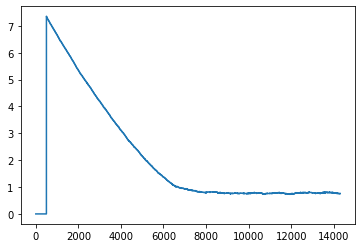

In [105]:
plt.plot(m_avgs)

In [106]:
from fastai.basic_train import Learner
this_m = MyTabularLearner(data, [1000, 500, 200], [0.05, 0.1, 0.1], 0.1).cuda()
learn = Learner(data, this_m)

epoch,train_loss,valid_loss,time


LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


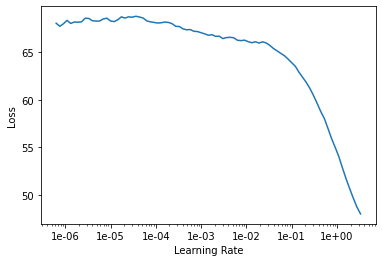

In [108]:
learn.lr_find()
learn.recorder.plot()

In [109]:
learn.fit_one_cycle(1, max_lr = 1e-02)

epoch,train_loss,valid_loss,time
0,0.899999,0.084772,02:38
